Look at how the template building vs the baseline looks after 3 months

In [1]:
import os
import shutil

import rubin_sim.maf.metric_bundles as metric_bundles
import rubin_sim.maf.metrics as metrics
import rubin_sim.maf.slicers as slicers

from rubin_sim.maf.batches.common import standard_summary

import rubin_sim.maf.batches as batches
import rubin_sim.maf.db as db
import rubin_sim.maf.metric_bundles as mb

import healpy as hp
import matplotlib.pylab as plt
%matplotlib inline
import numpy as np

In [2]:
nside = 128
def tt_batch(run_name, time_min=16):

    standard_stats = standard_summary()
    bundle_list = []
    bands = 'ugrizy'
    night_lim = 30*3
    for band in bands:
        sql = "night < %i and visitExposureTime > %f and band = '%s'" % (night_lim, time_min, band)

        slicer = slicers.HealpixSlicer(nside=nside)
        metric = metrics.TemplateTime(seeing_percentile=100,
                                      m5_percentile=100,
                                      n_images_in_template=3,)

        bundle_list.append(metric_bundles.MetricBundle(metric, 
                                                       slicer, 
                                                       sql,
                                                       summary_metrics=standard_stats,
                                                       run_name=run_name))

    bd = metric_bundles.make_bundles_dict_from_list(bundle_list)

    return bd

Healpix slicer using NSIDE=128, approximate resolution 27.483891 arcminutes
Healpix slicer using NSIDE=128, approximate resolution 27.483891 arcminutes
Healpix slicer using NSIDE=128, approximate resolution 27.483891 arcminutes
Healpix slicer using NSIDE=128, approximate resolution 27.483891 arcminutes
Healpix slicer using NSIDE=128, approximate resolution 27.483891 arcminutes
Healpix slicer using NSIDE=128, approximate resolution 27.483891 arcminutes


/Users/yoachim/git_repos/rubin_sim/rubin_sim/maf/plots/plot_handler.py:665: UserWarning: Cannot plot object metric values with this plotter.
  warnings.warn("Cannot plot object metric values with this plotter.")
/Users/yoachim/git_repos/rubin_sim/rubin_sim/maf/utils/maf_utils.py:163: UserWarning: Optimal bin calculation calculated NaN: returning 200
  warnings.warn("Optimal bin calculation calculated NaN: returning %i" % (nbin_max))
/Users/yoachim/git_repos/rubin_sim/rubin_sim/maf/utils/maf_utils.py:153: UserWarning: Optimal bin calculation tried to make 7984 bins, returning 200
  warnings.warn(
/Users/yoachim/git_repos/rubin_sim/rubin_sim/maf/utils/maf_utils.py:153: UserWarning: Optimal bin calculation tried to make 210 bins, returning 200
  warnings.warn(
/Users/yoachim/git_repos/rubin_sim/rubin_sim/maf/utils/maf_utils.py:153: UserWarning: Optimal bin calculation tried to make 4937 bins, returning 200
  warnings.warn(
/Users/yoachim/git_repos/rubin_sim/rubin_sim/maf/plots/plot_handle

Healpix slicer using NSIDE=128, approximate resolution 27.483891 arcminutes
Healpix slicer using NSIDE=128, approximate resolution 27.483891 arcminutes
Healpix slicer using NSIDE=128, approximate resolution 27.483891 arcminutes
Healpix slicer using NSIDE=128, approximate resolution 27.483891 arcminutes
Healpix slicer using NSIDE=128, approximate resolution 27.483891 arcminutes
Healpix slicer using NSIDE=128, approximate resolution 27.483891 arcminutes


/Users/yoachim/git_repos/rubin_sim/rubin_sim/maf/plots/plot_handler.py:665: UserWarning: Cannot plot object metric values with this plotter.
  warnings.warn("Cannot plot object metric values with this plotter.")
/Users/yoachim/git_repos/rubin_sim/rubin_sim/maf/utils/maf_utils.py:163: UserWarning: Optimal bin calculation calculated NaN: returning 200
  warnings.warn("Optimal bin calculation calculated NaN: returning %i" % (nbin_max))
/Users/yoachim/git_repos/rubin_sim/rubin_sim/maf/utils/maf_utils.py:153: UserWarning: Optimal bin calculation tried to make 9973 bins, returning 200
  warnings.warn(
/Users/yoachim/git_repos/rubin_sim/rubin_sim/maf/utils/maf_utils.py:153: UserWarning: Optimal bin calculation tried to make 6057 bins, returning 200
  warnings.warn(
/Users/yoachim/git_repos/rubin_sim/rubin_sim/maf/plots/plot_handler.py:665: UserWarning: Cannot plot object metric values with this plotter.
  warnings.warn("Cannot plot object metric values with this plotter.")
/Users/yoachim/git_

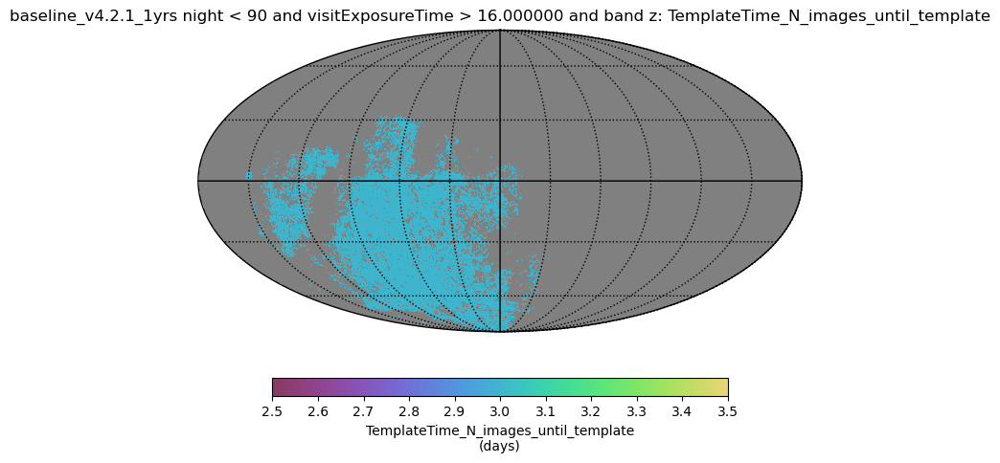

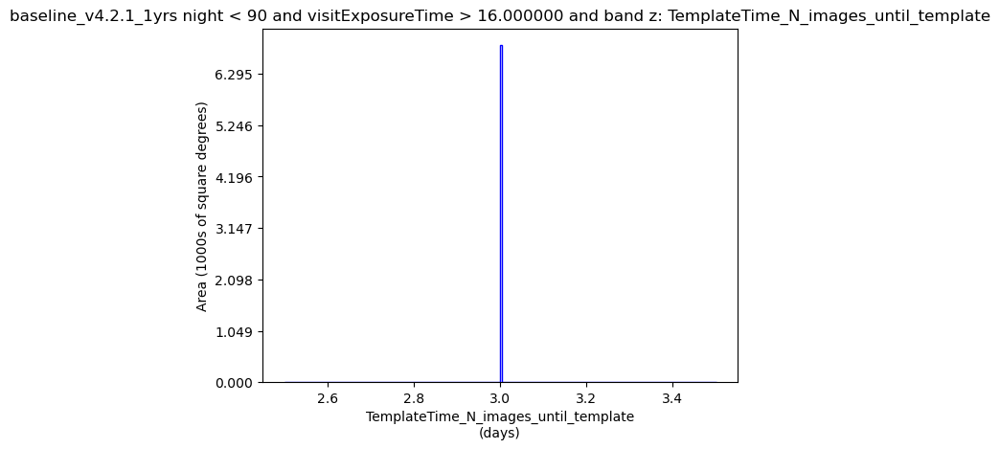

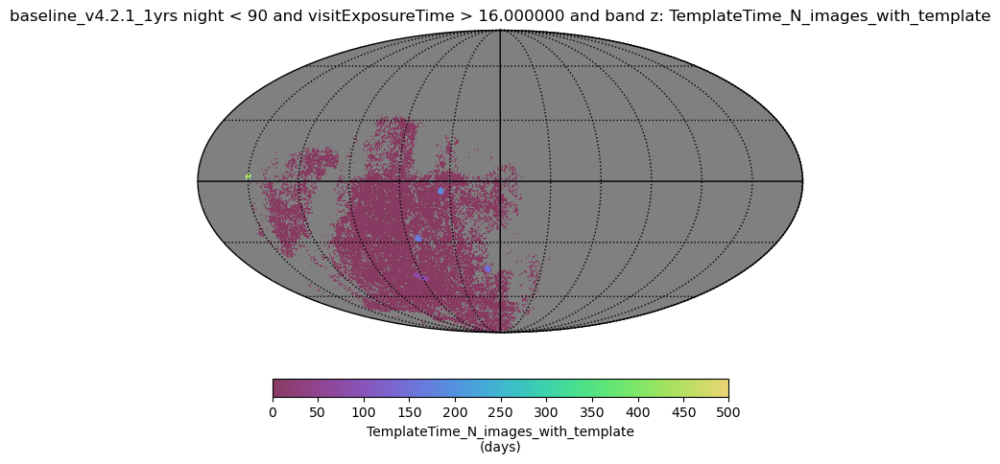

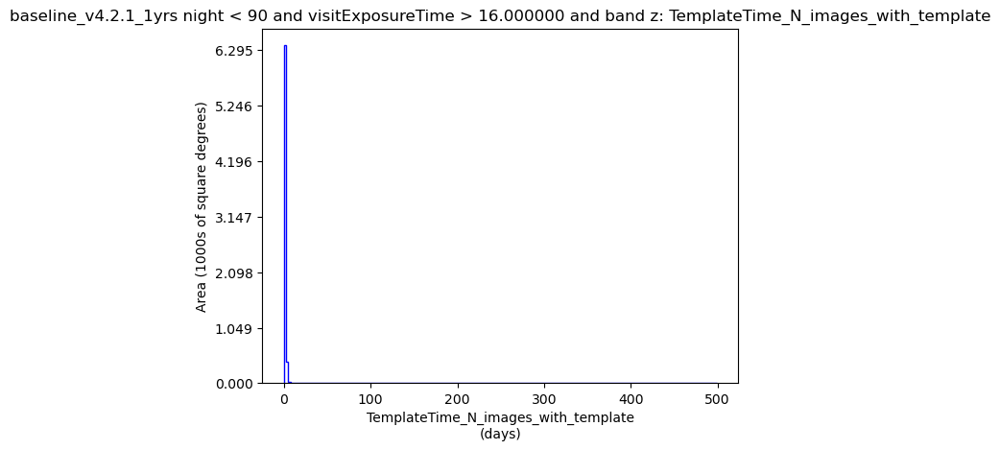

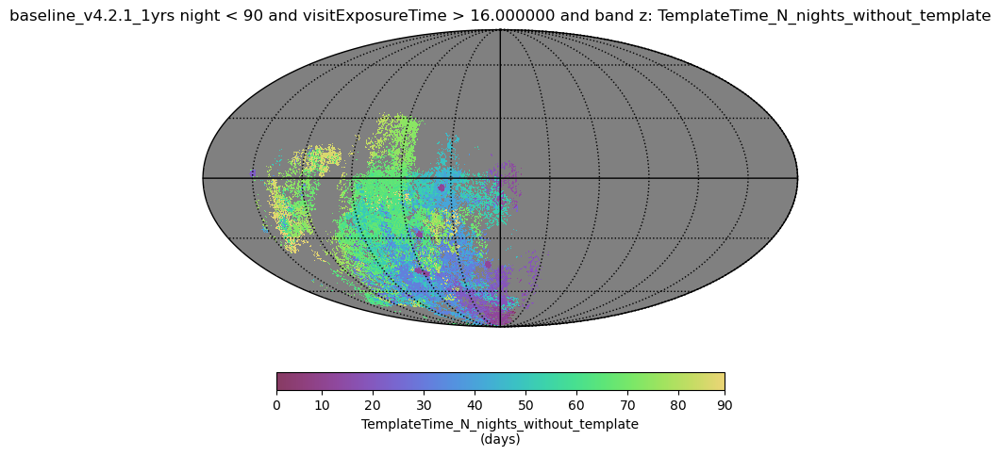

...

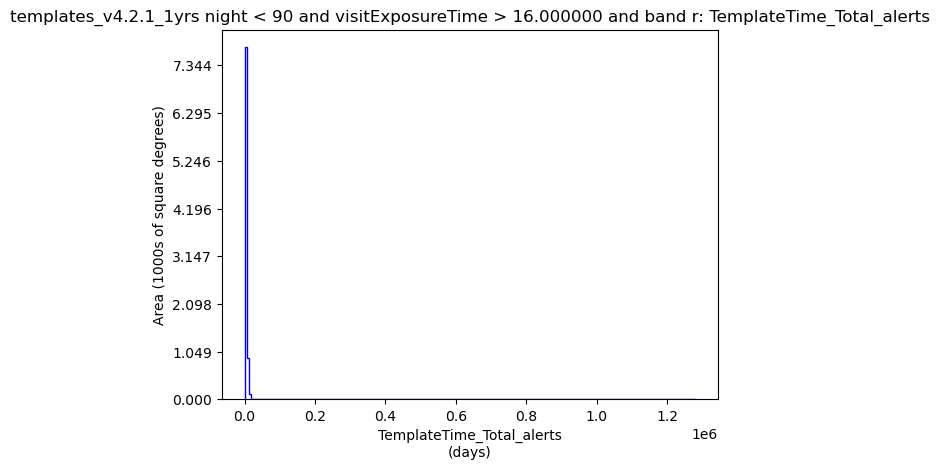

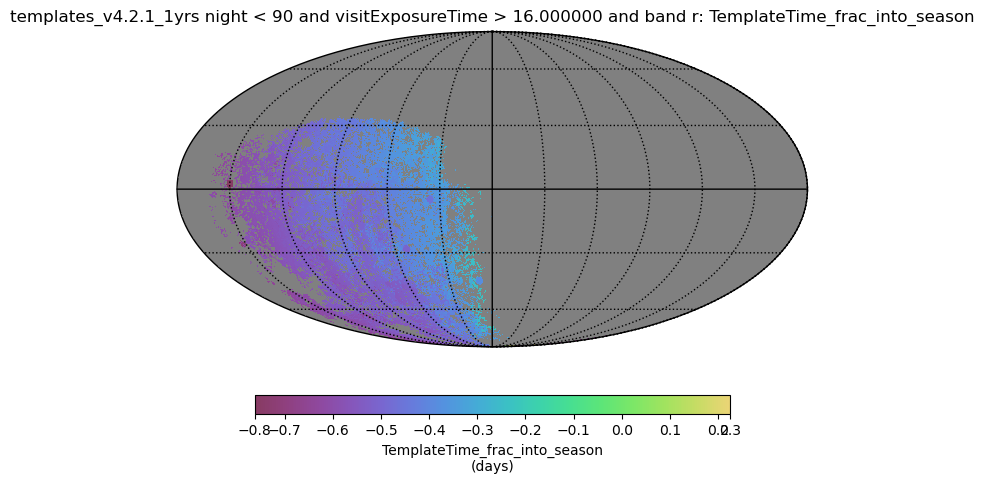

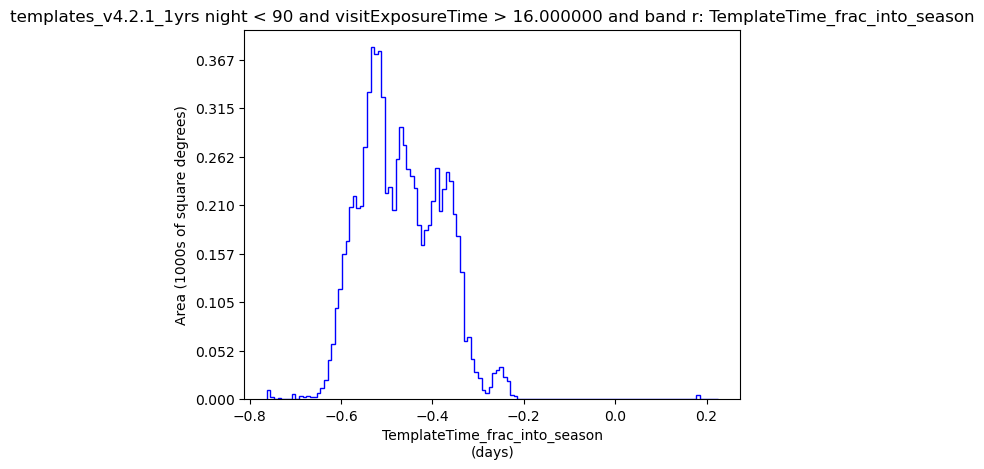

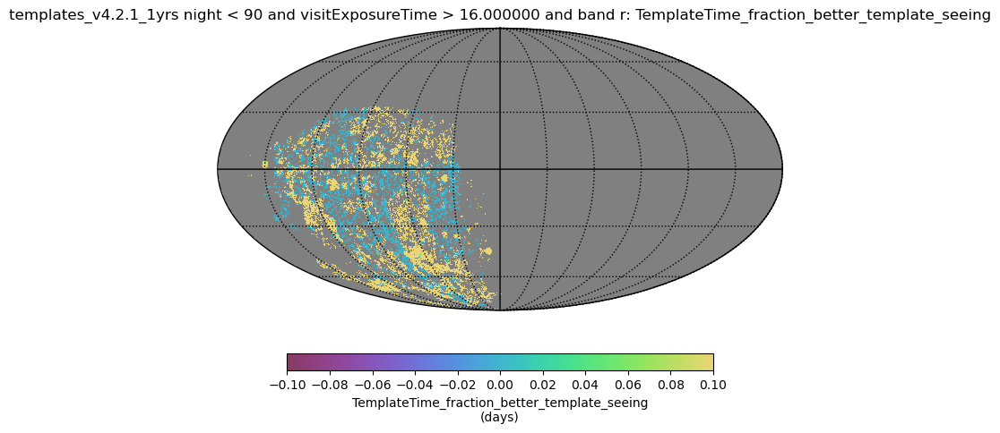

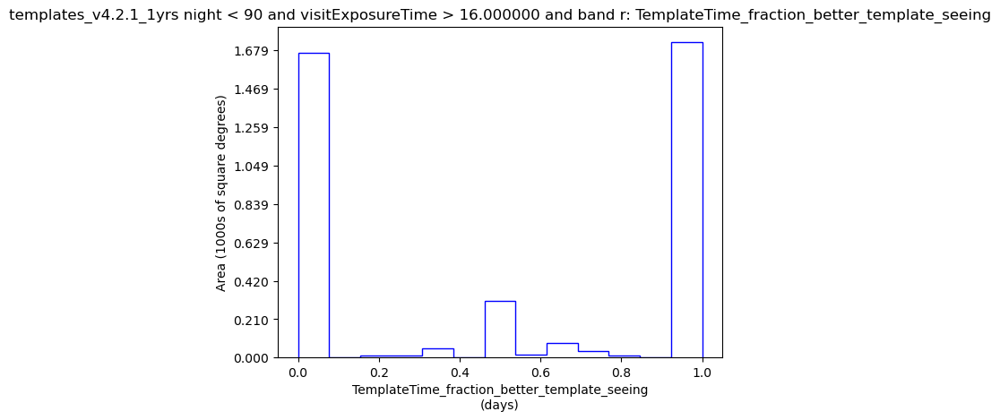

In [3]:
files = ['baseline_v4.2.1_1yrs.db', 'templates_v4.2.1_1yrs.db']
run_names = [filename.replace('.db', '') for filename in files]
groups = []
for filename, name in zip(files, run_names):

    bdict = tt_batch(name)
    results_db = db.ResultsDb(out_dir=name + "_ttime")
    group = mb.MetricBundleGroup(
        bdict,
        filename,
        out_dir="temp",
        results_db=results_db,
        save_early=False,
    )
    group.run_all()
    group.plot_all(closefigs=False)
    groups.append(group)

In [4]:
a = hp.nside2pixarea(nside, degrees=True)

print('    baseline, templates' )

sums = np.zeros(2)
for bandname in 'ugrizy':
    areas = []
    areas.append(np.where(~groups[0].bundle_dict['baseline_v4_2_1_1yrs_TemplateTime_night_lt_90_and_visitExposureTime_gt_16_000000_and_band_%s_HEAL' % (bandname)].metric_values.mask)[0].size * a)
    areas.append(np.where(~groups[1].bundle_dict['templates_v4_2_1_1yrs_TemplateTime_night_lt_90_and_visitExposureTime_gt_16_000000_and_band_%s_HEAL' % (bandname)].metric_values.mask)[0].size * a)
    print(bandname, ' ', areas)
    sums[0] += areas[0]
    sums[1] += areas[1]

print('  ', sums[0], sums[1])

    baseline, templates
u   [7496.990485848747, 8794.748284756513]
g   [11924.05464092635, 10995.376222500194]
r   [12102.824187356327, 8865.248950954252]
i   [6945.364737533708, 9749.02515936161]
z   [6874.234601102062, 10173.078273604553]
y   [6576.075533640795, 8023.437424807452]
   51919.54418640799 56600.91431598458


In [5]:
# So, after 3 months, only about a 10% increase in the area that I have templates for